In [1]:
# manipulacja danymi
import numpy as np
import pandas as pd

# wizualizacja
import matplotlib.pyplot as plt
import seaborn as sns

# podział danych na zbiory treningowe/walidacyjne/testowe
from sklearn.model_selection import train_test_split, GridSearchCV

# budowa Pipeline
from sklearn.pipeline import FeatureUnion, Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer

# Preprocessing
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, PolynomialFeatures, PowerTransformer

# redukcja wymiarowości
from sklearn.decomposition import PCA

# model
from sklearn.linear_model import LogisticRegression

# ewaluacja
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, f1_score, roc_auc_score

In [2]:
dataset = pd.read_csv('titanic.csv')
dataset

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...,...
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.0000,NaN,S
887,888,1,1,"Graham, Miss. Margaret Edith",female,19.0,0,0,112053,30.0000,B42,S
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.4500,NaN,S
889,890,1,1,"Behr, Mr. Karl Howell",male,26.0,0,0,111369,30.0000,C148,C


In [3]:
X = dataset.drop(['Survived'], axis=1).copy()
y = dataset['Survived'].copy()
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

In [5]:
class Filter_Name(BaseEstimator, TransformerMixin):
    def __init__(self, column):
        self.column = column

    def fit(self, X, y = None ):
        return self

    def transform(self, X, y = None ):
        X_transformed = X.copy()
        column = self.column
        X_transformed[column] = X_transformed[column].str.split(', ', expand=True)[1].str.split('.', expand=True)[0]
        X_transformed.loc[~X_transformed[column].isin(['Mr', 'Miss', 'Mrs']), column] = 'Other'
        return X_transformed

In [7]:
metrics_dataframe = pd.DataFrame(columns = ['Model', 'F1_score', 'AUC'])
metrics_dataframe
models = []
models_names = []
predictions_proba_list = []

def calculate_metrics(model, name, X_checked, y_checked):
    models.append(model)
    models_names.append(name)
    global metrics_dataframe
    predictions = model.predict(X_checked)
    predictions_proba = model.predict_proba(X_checked)
    predictions_proba_list.append(predictions_proba[:,1])

    ############## metryki dla sprawdzanego modelu ################

    # Precision, Recall, F1, Accuracy
    print(classification_report(y_checked, predictions))

    # Confusion matrix
    plt.figure()
    cm = confusion_matrix(y_checked, predictions)
    ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
    ax.set_title('Confusion Matrix\n\n')
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ')
    plt.show()

    # plot ROC curve
    fig = plt.figure(figsize=(6, 6))
    plt.plot([0, 1], [0, 1], 'k--')
    for model_selected, name_selected, pred_proba in zip(models, models_names, predictions_proba_list):
        fpr, tpr, thresholds = roc_curve(y_checked, pred_proba)
        plt.plot(fpr, tpr, label=name_selected)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='lower right')
    plt.show()

    f1_metric = f1_score(y_checked, predictions)
    auc_metric = roc_auc_score(y_checked, predictions_proba[:,1])
    new_row = pd.DataFrame([{'Model': name, 'F1_score': f1_metric, 'AUC': auc_metric}])
    metrics_dataframe = pd.concat([metrics_dataframe, new_row], ignore_index=True)
    return metrics_dataframe

In [13]:
num_features = ['Age', 'SibSp', 'Parch', 'Fare']
cat_features = ['Name', 'Sex', 'Embarked']

# przygotowanie wartości numerycznych
num_preparation = Pipeline(steps=[
    ('fill_missings', SimpleImputer(strategy='mean')),
    ('polynomial_features', PolynomialFeatures(degree=3)),
    ('scaler_1', StandardScaler()),
    ('pca', PCA(n_components=0.95)),
    ('scaler_2', StandardScaler())
])

# przygotowanie wartości kategorycznych
cat_preparation = Pipeline(steps=[
    ('filter_name', Filter_Name(column='Name')),
    ('fill_missings', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(sparse_output=False ,handle_unknown='ignore'))
])

# transformer = wartości numeryczne oraz kategoryczne
data_preparation = ColumnTransformer(transformers=[
    ('numeric_preprocessing', num_preparation, num_features),
    ('categorical_preprocessing', cat_preparation, cat_features)
])

model_pipeline_v1 = Pipeline(steps=[('preprocessor', data_preparation),
                                    ('model', LogisticRegression(max_iter=10000))])
params = {
    'preprocessor__numeric_preprocessing__fill_missings__strategy': ['mean', 'median'],
    'preprocessor__numeric_preprocessing__polynomial_features__degree': [1, 2, 3, 4],
    'preprocessor__numeric_preprocessing__pca__n_components': [0.85, 0.90, 0.95, 0.99, 0.99999],
    'model__C': np.logspace(-4, 4, 50)
}

grid_search = GridSearchCV(model_pipeline_v1, params, cv=10, n_jobs=-1, verbose=10, scoring='f1_macro')
grid_search.fit(X_train, y_train)
print('Wybrane hiperparametry: ', grid_search.best_params_)
model_v1 = grid_search.best_estimator_

Fitting 10 folds for each of 2000 candidates, totalling 20000 fits
[CV 8/10; 1/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.385 total time=   0.0s
[CV 8/10; 3/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 3/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_prepr

[CV 9/10; 46/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 46/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.383 total time=   0.0s
[CV 10/10; 46/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 46/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_prepro

[CV 5/10; 83/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 83/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 6/10; 83/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocereprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.383 total time=   0.0s
[CV 10/10; 77/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__

[CV 8/10; 116/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 116/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.385 total time=   0.0s
[CV 9/10; 116/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 116/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__

[CV 2/10; 225/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 225/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.380 total time=   0.0s=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.380 total time=   0.0s
[CV 4/10; 205/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 205/2000] END model__C=0.00065512

[CV 3/10; 186/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 186/2000] END model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 4/10; 186/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 186/2000] END model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_

[CV 1/10; 216/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.380 total time=   0.0s
[CV 6/10; 201/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 201/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.380 total time=   0.0s
[CV 7/10; 201/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 261/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 261/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.380 total time=   0.0s
[CV 7/10; 261/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 261/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__nume

[CV 7/10; 312/2000] START model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 216/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 216/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.380 total time=   0.0s
[CV 3/10; 216/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_

[CV 1/10; 331/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.494 total time=   0.0s
[CV 2/10; 331/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 331/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.458 total time=   0.0s
[CV 3/10; 331/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 255/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 255/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 7/10; 255/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 7/10; 255/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_prep

[CV 7/10; 225/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.385 total time=   0.0s
[CV 8/10; 225/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 225/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.427 total time=   0.0s
[CV 9/10; 225/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 8/10; 321/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 321/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.538 total time=   0.0s
[CV 9/10; 321/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 321/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_prep

[CV 1/10; 382/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 382/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.589 total time=   0.0s
[CV 2/10; 382/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 382/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__nume

[CV 1/10; 333/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 333/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.528 total time=   0.0s
[CV 2/10; 333/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 333/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_prep

[CV 7/10; 438/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 438/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.751 total time=   0.0s
[CV 8/10; 438/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 438/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocess

[CV 5/10; 403/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.743 total time=   0.0s
[CV 6/10; 403/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 403/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_ings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.693 total time=   0.0s
[CV 3/10; 418/2000] START model__C=0.004291934260

[CV 9/10; 417/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.741 total time=   0.0s
[CV 10/10; 417/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 417/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 9/10; 430/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_c

[CV 4/10; 363/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.494 total time=   0.0s
[CV 5/10; 363/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 363/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.528 total time=   0.0s
[CV 6/10; 363/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 7/10; 464/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 464/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.853 total time=   0.0s
[CV 8/10; 464/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 464/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__nume

[CV 7/10; 486/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 486/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.853 total time=   0.0s
[CV 8/10; 486/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 486/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessin

[CV 7/10; 434/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.729 total time=   0.0s
[CV 8/10; 434/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 434/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.658 total time=   0.0s
[CV 9/10; 434/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compon

[CV 5/10; 469/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.834 total time=   0.0s
[CV 6/10; 469/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 469/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.656 total time=   0.0s
[CV 7/10; 469/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_co

[CV 5/10; 538/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.920 total time=   0.0s
[CV 6/10; 538/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 538/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing13257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.887 total time=   0.0s
[CV 6/10; 527/2000] START model__C=0.013257113655901081,

[CV 2/10; 534/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.702 total time=   0.0s
[CV 3/10; 534/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 534/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.828 total time=   0.0s
[CV 4/10; 534/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 8/10; 552/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 552/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.735 total time=   0.0s
[CV 9/10; 552/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 552/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_

[CV 10/10; 513/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 513/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.728 total time=   0.0s
[CV 1/10; 530/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 530/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_pr

[CV 8/10; 582/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 582/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 3/10; 589/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 589/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_

[CV 6/10; 578/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.729 total time=   0.0s
[CV 7/10; 578/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 578/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, prep__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.754 total time=   0.0s
[CV 9/10; 563/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85,

[CV 9/10; 655/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.836 total time=   0.0s
[CV 10/10; 655/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3r__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.781 total time=   0.0s
[CV 1/10; 557/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features

[CV 2/10; 566/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.702 total time=   0.0s
[CV 3/10; 566/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 566/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.823 total time=   0.0s
[CV 4/10; 566/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 8/10; 615/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 615/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.749 total time=   0.0s
[CV 9/10; 615/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 615/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessin

[CV 7/10; 653/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.838 total time=   0.0s
[CV 8/10; 653/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 653/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 9/10; 653/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 8/10; 676/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.749 total time=   0.0s
[CV 9/10; 676/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 676/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.836 total time=   0.0s
[CV 10/10; 676/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 7/10; 711/2000] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.870 total time=   0.0s
[CV 8/10; 711/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 711/2000] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.768 total time=   0.0s
[CV 9/10; 711/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 1/10; 733/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 733/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 733/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.721 total time=   0.0s
[CV 1/10; 754/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99,

[CV 8/10; 765/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 765/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 9/10; 765/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 765/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 4/10; 748/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.694 total time=   0.0s
[CV 5/10; 748/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 748/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.887 total time=   0.0s
[CV 6/10; 748/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 10/10; 739/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 739/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.749 total time=   0.0s
[CV 1/10; 740/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 740/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeri

[CV 7/10; 788/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 788/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 788/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 788/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 5/10; 738/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.904 total time=   0.0s
[CV 6/10; 738/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 738/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.749 total time=   0.0s
[CV 7/10; 738/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_component

[CV 9/10; 791/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.775 total time=   0.0s
[CV 10/10; 791/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 791/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.746 total time=   0.0s
[CV 1/10; 792/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_componen

[CV 9/10; 761/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 761/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.775 total time=   0.0s
[CV 10/10; 761/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=
[CV 3/10; 769/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 769/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_m

[CV 3/10; 819/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 819/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.816 total time=   0.0s
[CV 4/10; 819/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 819/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_

[CV 8/10; 875/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 875/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.768 total time=   0.0s
[CV 9/10; 875/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 875/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preproce

[CV 3/10; 784/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.840 total time=   0.0s
[CV 4/10; 784/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 4/10; 784/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.699 total time=   0.0s
[CV 7/10; 819/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 5/10; 866/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.921 total time=   0.0s
[CV 6/10; 866/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 866/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 7/10; 866/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 1/10; 892/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.843 total time=   0.0s
[CV 2/10; 892/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 892/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.702 total time=   0.0s
[CV 3/10; 892/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 2/10; 904/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 904/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.702 total time=   0.0s
[CV 3/10; 904/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 904/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preproce

[CV 7/10; 859/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.853 total time=   0.0s
[CV 8/10; 859/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 859/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.823 total time=   0.0s
[CV 9/10; 859/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 6/10; 930/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 7/10; 930/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 930/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 930/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 9/10; 942/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.778 total time=   0.0s
[CV 10/10; 942/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 942/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.795 total time=   0.0s
[CV 1/10; 943/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 8/10; 936/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 936/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 936/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 936/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__p

[CV 6/10; 909/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 909/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 909/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 909/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 8/10; 960/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.759 total time=   0.0s
[CV 9/10; 960/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 960/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.775 total time=   0.0s
[CV 10/10; 960/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_comp

[CV 7/10; 993/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 993/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 993/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 993/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preproce

[CV 3/10; 953/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.783 total time=   0.0s
[CV 4/10; 953/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 953/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 5/10; 953/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 7/10; 1018/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1018/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1018/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1018/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_

[CV 1/10; 1058/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 2/10; 1058/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1058/20atures__degree=3
[CV 5/10; 1019/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.903 total time=   0.0s
[CV 6/10; 1019/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numer

[CV 1/10; 1075/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.843 total time=   0.0s
[CV 2/10; 1075/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1075/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.740 total time=   0.0s
[CV 3/10; 1075/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 9/10; 1077/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1077/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1077/2000] START model__C=1.757510
[CV 9/10; 1014/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1014/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pc

[CV 10/10; 1069/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 1069/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 1/10; 1070/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1070/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_pr

[CV 8/10; 1093/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1093/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1093/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1093/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, prep

[CV 4/10; 1111/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.681 total time=   0.0s
[CV 5/10; 1111/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1111/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.906 total time=   0.0s
[CV 6/10; 1111/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 1/10; 1105/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 1105/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 1105/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1105/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 7/10; 1145/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1145/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1145/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1145/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessin

[CV 6/10; 1147/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 5/10; 1160/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 1160/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.858 total time=   0.0s
[CV 6/10; 1160/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_component

[CV 8/10; 1211/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.768 total time=   0.0s
[CV 9/10; 1211/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1211/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 10/10; 1211/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, 

[CV 8/10; 1155/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 1155/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.768 total time=   0.0s
[CV 9/10; 1155/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1155/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preproce

[CV 10/10; 1189/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 1189/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 1/10; 1190/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepnumeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1156/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=median, pre

[CV 1/10; 1189/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 1189/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 1189/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 7/10; 1203/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85

[CV 3/10; 1170/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.847 total time=   0.0s
[CV 4/10; 1170/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 1170/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.681 total time=   0.0s
[CV 5/10; 1170/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 1/10; 1267/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.826 total time=   0.0s
[CV 2/10; 1267/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1267/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__pmponents=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 1185/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca_

[CV 9/10; 1277/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1277/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1277/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_featurlynomial_features__degree=1;, score=0.816 total time=   0.0s
[CV 4/10; 1281/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preproc

[CV 5/10; 1249/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 1249/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.921 total time=   0.0s
[CV 6/10; 1249/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__num6855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.903 total time=   0.0s
[CV 6/10; 1219/2000] START mo

[CV 7/10; 1319/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 7/10; 1319/2000] END model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.838 total time=   0.0s
[CV 8/10; 1319/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_componor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 10/10; 1255/2000] START model__C=11.513953993264458, preproc

[CV 4/10; 1325/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 1325/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 5/10; 1325/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 1325/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 10/10; 1267/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.810 total time=   0.0s
[CV 1/10; 1268/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1268/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.826 total time=   0.0s
[CV 2/10; 1268/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 5/10; 1329/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.921 total time=   0.0s
[CV 6/10; 1329/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 1329/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1329/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, p

[CV 7/10; 1245/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1245/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1245/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1245/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 5/10; 1368/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 1368/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.921 total time=   0.0s
[CV 6/10; 1368/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 6/10; 1368/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 8/10; 1365/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1365/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1365/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1365/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, prep

[CV 6/10; 1336/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 7/10; 1336/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 1336/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.853 total time=   0.0s
[CV 8/10; 1336/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, p

[CV 2/10; 1342/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.740 total time=   0.0s
[CV 3/10; 1342/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 1342/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.847 total time=   0.0s
[CV 4/10; 1342/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 7/10; 1389/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1389/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1389/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1389/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 8/10; 1401/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1401/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1401/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1401/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__p

[CV 8/10; 1418/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 9/10; 1418/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1418/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 10/10; 1418/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 6/10; 1449/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1449/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1449/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1449/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 9/10; 1460/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1460/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.760 total time=   0.0s
[CV 10/10; 1460/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1460/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_pr

[CV 10/10; 1463/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 1/10; 1464/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1464/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.828 total time=   0.0s
[CV 2/10; 1464/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 2/10; 1505/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1505/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 1505/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.816 total time=   0.0s
[CV 4/10; 1505/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 3/10; 1439/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.816 total time=   0.0s
[CV 4/10; 1439/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 1439/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.727 total time=   0.0s
[CV 5/10; 1439/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 9/10; 1484/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1484/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.778 total time=   0.0s
[CV 10/10; 1484/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1484/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocess

[CV 10/10; 1468/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 1/10; 1469/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1469/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 1469/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 4/10; 1528/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.662 total time=   0.0s
[CV 1/10; 1538/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1538/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 2/10; 1538/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 1/10; 1522/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1522/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 1522/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1522/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessin

[CV 9/10; 1559/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1559/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.778 total time=   0.0s
[CV 10/10; 1559/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 1559/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor

[CV 8/10; 1525/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1525/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1525/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__filssing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 1/10; 1544/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compon

[CV 1/10; 1563/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.811 total time=   0.0s
[CV 2/10; 1563/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1563/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, scoregree=1
[CV 10/10; 1549/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numer

[CV 5/10; 1594/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.906 total time=   0.0s
[CV 6/10; 1594/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 1594/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 7/10; 1594/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 5/10; 1623/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.921 total time=   0.0s
[CV 6/10; 1623/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 1623/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 7/10; 1623/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.8

[CV 1/10; 1582/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 1582/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1582/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.740 total time=   0.0s
[CV 3/10; 1582/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 10/10; 1643/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 1643/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 1/10; 1644/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1644/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing_

[CV 5/10; 1653/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.921 total time=   0.0s
[CV 6/10; 1653/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 1653/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1653/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, prepr

[CV 9/10; 1608/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1608/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 10/10; 1608/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1608/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__pol

[CV 6/10; 1666/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.787 total time=   0.0s
[CV 7/10; 1666/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1666/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1666/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 9/10; 1702/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1702/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 10/10; 1702/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 1702/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_prepro

[CV 8/10; 1713/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1713/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1713/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1734/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_pre

[CV 4/10; 1711/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 1711/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.681 total time=   0.0s
[CV 5/10; 1711/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1711/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preproce

[CV 4/10; 1667/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.662 total time=   0.0s
[CV 5/10; 1667/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1667/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.921 total time=   0.0s
[CV 6/10; 1667/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 8/10; 1728/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.773 total time=   0.0s
[CV 9/10; 1728/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1728/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 10/10; 1728/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, prep

[CV 1/10; 1755/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.843 total time=   0.0s
[CV 2/10; 1755/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1755/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.740 total time=   0.0s
[CV 3/10; 1755/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 1704/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.787 total time=   0.0s
[CV 7/10; 1704/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 1704/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 1704/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.8

[CV 10/10; 1735/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 1735/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.812 total time=   0.0s
[CV 1/10; 1736/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1736/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocess

[CV 7/10; 1789/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1789/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1789/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1789/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 1758/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 1758/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.729 total time=   0.0s
[CV 7/10; 1758/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1758/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__

[CV 8/10; 1781/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1781/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1781/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1781/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_component

[CV 10/10; 1804/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1804/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.792 total time=   0.0s
[CV 1/10; 1805/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1805/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 9/10; 1849/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1849/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 1849/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 3/10; 1861/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, prepr

[CV 6/10; 1858/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.729 total time=   0.0s
[CV 7/10; 1858/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1858/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1858/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9999

[CV 6/10; 1785/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1785/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1785/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1785/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 6/10; 1896/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 7/10; 1896/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 1896/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.853 total time=   0.0s
[CV 8/10; 1896/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, p

[CV 8/10; 1877/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1877/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1877/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1877/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_

[CV 5/10; 1882/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 1882/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.921 total time=   0.0s
[CV 6/10; 1882/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 1882/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessin

[CV 7/10; 1904/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 1904/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1904/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.759 total time=   0.0s
[CV 9/10; 1904/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 2/10; 1928/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.740 total time=   0.0s
[CV 3/10; 1928/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1928/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.847 total time=   0.0s
[CV 4/10; 1928/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preproces

[CV 9/10; 1982/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 8/10; 1872/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1872/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1872/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor

[CV 4/10; 1986/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.681 total time=   0.0sWybrane hiperparametry:  {'model__C': 0.12648552168552957, 'preprocessor__numeric_preprocessing__fill_missings__strategy': 'mean', 'preprocessor__numeric_preprocessing__pca__n_components': 0.99, 'preprocessor__numeric_preprocessing__polynomial_features__degree': 3}


Fitting 10 folds for each of 2000 candidates, totalling 20000 fits

[CV 7/10; 1979/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 7/10; 1979/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.838 total time=   0.0s
[CV 8/10; 1979/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 1979/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999

[CV 2/10; 1987/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.740 total time=   0.0s
[CV 6/10; 1987/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 1987/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 10/10; 1987/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__pol

[CV 4/10; 1996/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 4/10; 1996/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.694 total time=   0.0s
[CV 1/10; 1997/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1997/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree

[CV 10/10; 2/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.383 total time=   0.0s
[CV 5/10; 4/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 4/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.380 total time=   0.0s
[CV 6/10; 4/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__de

[CV 2/10; 19/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 3/10; 19/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 19/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 4/10; 19/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomi

[CV 1/10; 26/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 26/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 2/10; 26/2000] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 26/2000] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total

[CV 7/10; 66/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.385 total time=   0.0s
[CV 8/10; 66/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 66/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.385 total time=   0.0s
[CV 9/10; 66/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 10/10; 62/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.383 total time=   0.0s
[CV 9/10; 75/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 75/2000] END model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.383 total time=   0.0s
[CV 10/10; 75/2000] START model__C=0.00014563484775012445, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_

[CV 4/10; 87/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 87/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 5/10; 87/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 87/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preproce

[CV 6/10; 105/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 105/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.380 total time=   0.0s
[CV 7/10; 105/2000] START model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 91/2000] END model__C=0.00021209508879201905, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeri

[CV 1/10; 126/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 2/10; 126/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 126/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 3/10; 126/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_component

[CV 2/10; 147/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 147/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 3/10; 147/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 147/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__nume

[CV 10/10; 140/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 140/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.383 total time=   0.0s
[CV 1/10; 141/2000] START model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 141/2000] END model__C=0.00030888435964774815, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocess

[CV 2/10; 176/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 163/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 163/2000] END model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.380 total time=   0.0s
[CV 3/10; 163/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_pr

[CV 9/10; 182/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 182/2000] END model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.383 total time=   0.0s
[CV 10/10; 182/2000] START model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 182/2000] END model__C=0.0004498432668969444, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__nu

[CV 1/10; 202/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 202/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.420 total time=   0.0s
[CV 2/10; 202/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 202/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_prep

[CV 9/10; 217/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.383 total time=   0.0s
[CV 10/10; 217/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 217/2000] END model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.383 total time=   0.0s
[CV 1/10; 218/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n

[CV 6/10; 242/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 7/10; 242/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 242/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.385 total time=   0.0s.0s
[CV 8/10; 230/2000] START model__C=0.0006551285568595509, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 2/10; 250/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 257/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.420 total time=   0.0s
[CV 2/10; 257/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 257/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__num

[CV 4/10; 254/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 5/10; 254/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 254/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 6/10; 254/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 7/10; 270/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 270/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.385 total time=   0.0s
[CV 8/10; 270/2000] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 270/2000] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__nume

[CV 3/10; 306/2000] START model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 306/2000] END model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.380 total time=   0.0s
[CV 4/10; 306/2000] START model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 306/2000] END model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_

[CV 1/10; 318/2000] START model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 318/2000] END model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.494 total time=   0.0s
[CV 1/10; 306/2000] START model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 306/2000] END model__C=0.0013894954943731374, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__

[CV 5/10; 330/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.494 total time=   0.0s
[CV 6/10; 330/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 330/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.458 total time=   0.0s
[CV 7/10; 330/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 9/10; 345/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.536 total time=   0.0s
[CV 10/10; 345/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 345/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.492 total time=   0.0s
[CV 1/10; 346/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_com

[CV 4/10; 352/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.420 total time=   0.0s
[CV 5/10; 352/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 352/2000] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.618 total time=   0.0s
[CV 6/10; 352/2000] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_co

[CV 5/10; 383/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 383/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.528 total time=   0.0s
[CV 6/10; 383/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 383/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__nume

[CV 6/10; 387/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 387/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.494 total time=   0.0s
[CV 7/10; 387/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 7/10; 387/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_

[CV 10/10; 399/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 399/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.568 total time=   0.0s
[CV 1/10; 400/2000] START model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 400/2000] END model__C=0.0029470517025518097, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, prep

[CV 9/10; 424/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.800 total time=   0.0s
[CV 10/10; 424/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 424/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.654 total time=   0.0s
[CV 1/10; 425/2000] START model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_comp

[CV 8/10; 435/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.645 total time=   0.0s
[CV 7/10; 448/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 448/2000] END model__C=0.0062505519252739694, preproce.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 425/2000] END model__C=0.004291934260128779, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.741 total time=   0.0s
[CV 10/10; 425/2000] START model__C=0.004291

[CV 1/10; 453/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 453/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.740 total time=   0.0s
[CV 2/10; 453/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 453/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_prep

[CV 3/10; 465/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.849 total time=   0.0s
[CV 4/10; 465/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
ll_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 6/10; 468/2000] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.729 total time=   0.0s
[CV 7/10; 468/2000]

[CV 5/10; 484/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.855 total time=   0.0s
[CV 6/10; 484/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 6/10; 484/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features
[CV 4/10; 472/2000] START model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__

[CV 1/10; 501/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 501/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.809 total time=   0.0s
[CV 2/10; 501/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__f9915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.608 total time=   0.0s
[CV 7/10; 499/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, pr

[CV 1/10; 517/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 517/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 508/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 508/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__nume

[CV 3/10; 515/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 515/2000] END model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.870 total time=   0.0s
[CV 4/10; 515/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numerial_features__degree=4;, score=0.729 total time=   0.0s
[CV 4/10; 520/2000] START model__C=0.009102981779915217, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV

[CV 1/10; 535/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 535/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.809 total time=   0.0s
[CV 2/10; 535/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.
[CV 5/10; 523/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.872 total time=   0.0s


[CV 8/10; 554/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.763 total time=   0.0s
[CV 9/10; 554/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 554/2000] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.815 total time=   0.0s
[CV 10/10; 554/2000] START model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 9/10; 563/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.804 total time=   0.0s
[CV 10/10; 563/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 563/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.742 total time=   0.0s
[CV 1/10; 564/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 7/10; 578/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 578/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 578/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 578/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__nume

[CV 3/10; 593/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.809 total time=   0.0s
[CV 4/10; 593/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 593/2000] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.662 total time=   0.0s
[CV 5/10; 593/2000] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compon

[CV 3/10; 612/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 612/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.840 total time=   0.0s
[CV 4/10; 612/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_pr768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 620/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__st

[CV 4/10; 627/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.675 total time=   0.0s
[CV 5/10; 627/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 627/2000] END model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.887 total time=   0.0s
[CV 6/10; 627/2000] START model__C=0.02811768697974228, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 2/10; 644/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.682 total time=   0.0s
[CV 3/10; 644/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 644/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.840 total time=   0.0s
[CV 4/10; 644/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.8

[CV 3/10; 651/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.826 total time=   0.0s
[CV 4/10; 651/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 651/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.662 total time=   0.0s
[CV 5/10; 651/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 6/10; 656/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.749 total time=   0.0s
[CV 1/10; 671/2000] START model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 671/2000] END model__C=0.040949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=00949150623804234, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 669/2000] END model__C=0.040949150623804234, preprocessor_

[CV 1/10; 687/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 687/2000] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.811 total time=   0.0sre=0.754 total time=   0.0s
[CV 9/10; 684/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features_

[CV 2/10; 685/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 685/2000] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.721 total time=   0.0s
[CV 3/10; 685/2000] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 685/2000] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__p

[CV 5/10; 722/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 722/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.889 total time=   0.0s
[CV 6/10; 722/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 722/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessin

[CV 9/10; 725/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 725/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.789 total time=   0.0s
[CV 10/10; 725/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preodel__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 738/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=

[CV 10/10; 732/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.746 total time=   0.0s
[CV 1/10; 733/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 733/2000] END model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 733/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, 

[CV 1/10; 766/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 766/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 766/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_prepr
[CV 8/10; 747/2000] START model__C=0.08685113737513521, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10

[CV 9/10; 775/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.821 total time=   0.0s
[CV 10/10; 775/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 775/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 762/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessin

[CV 3/10; 777/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 777/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.797 total time=   0.0s
[CV 4/10; 777/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 777/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_

[CV 6/10; 787/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 787/2000] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 7/10; 787/2000] START model__C=0.1264or__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.721 total time=   0.0s
[CV 3/10; 790/2000] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 790/2000] 

[CV 3/10; 810/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 4/10; 810/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 810/2000] END model__C=0.18420699693267145, preprocessor__numeric_preproces7145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 803/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85,

[CV 3/10; 834/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.830 total time=   0.0s
[CV 4/10; 834/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 834/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.681 total time=   0.0s
[CV 5/10; 834/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 835/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 835/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.749 total time=   0.0s
[CV 7/10; 83
[CV 8/10; 831/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 831/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor_

[CV 2/10; 836/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.727 total time=   0.0s
[CV 3/10; 836/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 836/2000] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.860 total time=   0.0s
[CV 4/10; 836/2000] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 6/10; 846/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 846/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 7/10; 846/2000] START model__C=0.2682695795279725, preprocessor__numer
[CV 6/10; 847/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 7/10; 847/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=

[CV 7/10; 863/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.870 total time=   0.0s
[CV 8/10; 863/2000] START model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 863/2000] END model__C=0.2682695795279725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preproc725, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 867/2000] END model__C=0.2682695795279725,

[CV 4/10; 885/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 885/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 5/10; 901/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 901/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing_

[CV 5/10; 902/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.921 total time=   0.0s
[CV 6/10; 902/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 902/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.787 total time=   0.0s
[CV 7/10; 902/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.8

[CV 3/10; 906/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.814 total time=   0.0s
[CV 4/10; 906/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 906/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.681 total time=   0.0s
[CV 5/10; 906/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, p

[CV 1/10; 918/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 918/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 2/10; 918/2000] START model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 918/2000] END model__C=0.3906939937054613, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__nume

[CV 7/10; 935/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.870 total time=   0.0s
[CV 8/10; 935/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 935/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.768 total time=   0.0s
[
[CV 1/10; 929/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 2/10; 943/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 943/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.702 total time=   0.0s
[CV 3/10; 943/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 943/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preproce

[CV 10/10; 946/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 1/10; 947/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 947/2000] END model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.811 total time=   0.0s
[CV 2/10; 947/2000] START model__C=0.5689866029018293, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, 

[CV 5/10; 966/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.921 total time=   0.0s
[CV 6/10; 966/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 966/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 7/10; 966/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preproces

[CV 9/10; 974/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.821 total time=   0.0s
[CV 10/10; 974/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 974/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.810 total time=   0.0s
[CV 1/10; 991/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, p

[CV 8/10; 996/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 996/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[C
[CV 6/10; 987/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.787 total time=   0.0s
[CV 7/10; 987/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 9/10; 993/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 993/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 993/2000] END model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 1/10; 994/2000] START model__C=0.8286427728546842, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 8/10; 1023/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.759 total time=   0.0sreprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1008/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__nu=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1012/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocess

[CV 3/10; 1021/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.800 total time=   0.0s
[CV 4/10; 1021/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 1021/2000] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 9/10; 1035/2000] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 3/10; 1054/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 1054/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.802 total time=   0.0s
[CV 4/10; 1054/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 1042/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_featu

[CV 9/10; 1066/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1066/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 10/10; 1066/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 10/10; 1066/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_prepro

[CV 7/10; 1077/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1077/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1077/2000] START model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1077/2000] END model__C=1.7575106248547894, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__

[CV 2/10; 1094/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1094/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.777 total time=   0.0s
[CV 3/10; 1094/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 1094/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__p

[CV 6/10; 1109/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1109/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1109/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_prumeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.740 total time=   0.0s
[CV 3/10; 1118/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_co

[CV 4/10; 1115/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.694 total time=   0.0s
[CV 5/10; 1115/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1115/2000] END model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.921 total time=   0.0s
[CV 6/10; 1115/2000] START model__C=2.559547922699533, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 10/10; 1138/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.812 total time=   0.0s
[CV 1/10; 1139/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 1139/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.843 total time=   0.0s
[CV 2/10; 1139/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 9/10; 1132/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1132/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.792 total time=   0.0s
[CV 10/10; 1132/2000] START model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1132/2000] END model__C=3.727593720314938, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing_

[CV 2/10; 1161/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 1161/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1161/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 1161/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__p

[CV 1/10; 1163/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 1163/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.828 total time=   0.0s
[CV 2/10; 1163/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1163/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__p

[CV 7/10; 1199/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 7/10; 1199/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.838 total time=   0.0s
[CV 8/10; 1199/2000] START model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 1199/2000] END model__C=5.428675439323859, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__nume

[CV 9/10; 1208/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 10/10; 1208/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1208/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 1/10; 1209/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, pr

[CV 10/10; 1201/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 1/10; 1202/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1202/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 1202/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, 

[CV 7/10; 1224/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 1224/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1224/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.759 total time=   0.0s
[CV 9/10; 1224/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components

[CV 1/10; 1229/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1229/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 1229/2000] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preproc
[CV 3/10; 1236/2000] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.845 total time=   0.0s
[CV 4/10; 1236/2000] START model__C=7.90604321

[CV 9/10; 1254/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1254/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.807 total time=   0.0s
[CV 10/10; 1254/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocess
[CV 4/10; 1252/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.662 total time=   0.0s
[CV 5/10; 1252/2000] START model__C=11.51395399326

[CV 9/10; 1263/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.778 total time=   0.1s
[CV 10/10; 1263/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 1263/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocess__degree=3;, score=0.787 total time=   0.0s
[CV 9/10; 1271/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1271/2000] END model_

[CV 5/10; 1270/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 1270/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.921 total time=   0.0s
[CV 6/10; 1270/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 6/10; 1270/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_prep

[CV 6/10; 1278/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.729 total time=   0.0s
[CV 7/10; 1278/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1278/2000] END model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1278/2000] START model__C=11.513953993264458, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_c

[CV 7/10; 1306/2000] END model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1306/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1306/2000] END model__C=16.768329368110066, presing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.906 total time=   0.0s
[CV 6/10; 1294/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_prepr

[CV 9/10; 1331/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1331/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 10/10; 1331/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, 
[CV 8/10; 1310/2000] START model__C=16.768329368110066, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1310/2000] END mod

[CV 8/10; 1327/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.773 total time=   0.0s
[CV 9/10; 1327/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1327/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.778 total time=   0.0s
[CV 10/10; 1327/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, prep

[CV 6/10; 1346/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.787 total time=   0.0s
[CV 7/10; 1346/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1346/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numer
[CV 1/10; 1338/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1338/2000] END model__C=24.420530945486497, preprocessor__

[CV 10/10; 1340/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.710 total time=   0.0s
[CV 1/10; 1341/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1341/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.826 total time=   0.0s
[CV 2/10; 1341/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_componen

[CV 8/10; 1358/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1358/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.754 total time=   0.0s
[CV 9/10; 1358/2000] START model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1358/2000] END model__C=24.420530945486497, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__

[CV 4/10; 1371/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.681 total time=   0.0s
[CV 5/10; 1371/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1371/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.906 total time=   0.0s
[CV 6/10; 1371/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, p

[CV 9/10; 1393/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1393/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.792 total time=   0.0s
[CV 10/10; 1393/2000] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_componponents=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1399/2000] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__nu

[CV 2/10; 1401/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 1401/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1401/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 1401/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__p

[CV 3/10; 1418/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 3/10; 1418/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.845 total time=   0.0s
[CV 4/10; 1418/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 4/10; 1418/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_prep

[CV 10/10; 1435/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.812 total time=   0.0s
[CV 1/10; 1436/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1436/2000] END model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.826 total time=   0.0s
[CV 2/10; 1436/2000] START model__C=51.79474679231202, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.

[CV 3/10; 1444/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1444/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.811 total time=   0.0s
[CV 4/10; 1444/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preppolynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1441/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing_

[CV 5/10; 1456/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.936 total time=   0.0s
[CV 6/10; 1456/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 6/10; 1456/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 1/10; 1471/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, pre

[CV 1/10; 1472/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.843 total time=   0.0s
[CV 2/10; 1472/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 2/10; 1472/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.745 total time=   0.0s
[CV 3/10; 1472/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 7/10; 1478/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1478/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1478/2000] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.7
[CV 3/10; 1469/2000] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preproces

[CV 7/10; 1487/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.870 total time=   0.0s
[CV 8/10; 1487/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 8/10; 1487/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocdian, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 1501/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_pr

[CV 2/10; 1507/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.740 total time=   0.0s
[CV 3/10; 1507/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 1507/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9,
[CV 9/10; 1494/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.807 total time=   0.0s


[CV 3/10; 1505/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 1505/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.816 total time=   0.0s
[CV 4/10; 1505/2000] START model__
[CV 9/10; 1515/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 10/10; 1515/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeri

[CV 1/10; 1522/2000] START model__C=159.9858719606 START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2odel__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 2/10; 1518/2000] START model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1518/2000] END model__C=109.85411419875572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__num

[CV 1/10; 1538/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1538/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.843 total time=   0.0s
[CV 2/10; 1538/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999
[CV 8/10; 1526/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.773 total time=  

[CV 8/10; 1545/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 8/10; 1545/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1545/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1545/2000] END model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preproce

[CV 10/10; 1561/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 10/10; 1561/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.810 total time=   0.0s
[CV 1/10; 1562/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1549/2000] START model__C=159.98587196060572, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_prepro

[CV 1/10; 1577/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0s
[CV 2/10; 1577/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 2/10; 1577/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1577/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_component

[CV 2/10; 1587/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1587/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.740 total time=   0.0s
[CV 3/10; 1587/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 1587/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preproce

[CV 8/10; 1596/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1596/2000] START model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1596/2000] END model__C=232.99518105153672, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_prepreprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1606/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components

[CV 3/10; 1615/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 3/10; 1615/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.845 total time=   0.0s
[CV 4/10; 1615/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 4/10; 1615/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__p

[CV 10/10; 1619/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.710 total time=   0.0s
[CV 1/10; 1620/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1620/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.826 total time=   0.0s
[CV 2/10; 1620/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0

[CV 6/10; 1633/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.768 total time=   0.0s
[CV 7/10; 1633/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 7/10; 1633/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.870 total time=   0.0s
[CV 8/10; 1633/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9

[CV 4/10; 1640/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.740 total time=   0.0s
[CV 5/10; 1640/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 5/10; 1640/2000] END model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.840 total time=   0.0s
[CV 6/10; 1640/2000] START model__C=339.3221771895323, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_compo

[CV 7/10; 1652/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 1652/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1652/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1652/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, prepr

[CV 4/10; 1666/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.681 total time=   0.0s
[CV 5/10; 1666/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 5/10; 1666/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessiC=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1668/2000] END model__C=4

[CV 10/10; 1679/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.710 total time=   0.0s
[CV 1/10; 1680/2000] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1680/2000] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__nll_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.792 total time=   0.0s
[CV 1/10; 1685/2000] START model__C=719.6856730011514, preprocessor_

[CV 5/10; 1711/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1711/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.906 total time=   0.0s
[CV 6/10; 1711/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_prep
[CV 6/10; 1686/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, scor

[CV 1/10; 1713/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1713/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total time=   0.0sng__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.870 total time=   0.0s
[CV 8/10; 1708/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1708/2000

[CV 4/10; 1719/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.727 total time=   0.0s
[CV 5/10; 1719/2000] START model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1719/2000] END model__C=719.6856730011514, preprocessor__numeric_preprocessing__fill_mng__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 1/10; 1721/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.811 total

[CV 1/10; 1735/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.843 total time=   0.0s
[CV 2/10; 1735/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 2/10; 1735/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 1/10; 1732/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1732/2000] END model__C=1

[CV 8/10; 1742/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1742/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.773 total time=   0.0s
[CV 9/10; 1742/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1742/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_prep

[CV 8/10; 1760/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1760/2000] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1760/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_pr
[CV 3/10; 1740/2000] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__de

[CV 9/10; 1776/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.792 total time=   0.0s
[CV 10/10; 1776/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1776/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missingsprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.745 total time=   0.0s
[CV 7/10; 1768/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocesso

[CV 1/10; 1790/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1790/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 1790/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1790/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_prep

[CV 8/10; 1774/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 9/10; 1774/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1774/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.807 total time=   0.0s
[CV 10/10; 1774/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, 

[CV 6/10; 1796/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 6/10; 1796/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 7/10; 1796/2000] START mod
[CV 1/10; 1799/2000] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 1/10; 1799/2000] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_component

[CV 8/10; 1818/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1818/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.768 total time=   0.0s
[CV 9/10; 1818/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 9/10; 1818/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_prep

[CV 3/10; 1808/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1808/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.847 total time=   0.0s
[CV 4/10; 1808/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 4/10; 1808/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polyn

[CV 1/10; 1834/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 1/10; 1834/2000] END model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.826 total time=   0.0s
[CV 2/10; 1834/2000] START model__C=2222.996482526191, preprocessor__numeric_preprocessing__fill_missings__stratnents=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 7/10; 1848/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__de

[CV 1/10; 1846/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.811 total time=   0.0s
[CV 2/10; 1846/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1846/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.759 total time=   0.0s
[CV 3/10; 1846/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor_

[CV 3/10; 1856/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 3/10; 1856/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.845 total time=   0.0s
[CV 4/10; 1856/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 4/10; 1856/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polyn

[CV 1/10; 1861/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.826 total time=   0.0s
[CV 2/10; 1861/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CVlynomial_features__degree=4
[CV 6/10; 1868/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.787 total time=   0.0s
[CV 7/10; 1868/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocess

[CV 9/10; 1888/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1888/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.764 total time=   0.0s
[CV 10/10; 1888/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1888/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing_

[CV 10/10; 1886/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.792 total time=   0.0s
[CV 9/10; 1899/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 9/10; 1899/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.778 total time=   0.0s
[CV 10/10; 1899/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=

[CV 1/10; 1906/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.811 total time=   0.0s
[CV 2/10; 1906/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 2/10; 1906/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strateing__polynomial_features__degree=1;, score=0.773 total time=   0.0s
[CV 9/10; 1917/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 9/10; 1917/2000] END mode

[CV 2/10; 1929/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.759 total time=   0.0s
[CV 3/10; 1929/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 3/10; 1929/2000] END model__ric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1936/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1936/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__

[CV 5/10; 1949/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 1949/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.921 total time=   0.0s
[CV 6/10; 1949/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 6/10; 1949/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preproce

[CV 7/10; 1942/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1942/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1942/2000] END model__C=6866.488_preprocessing__polynomial_features__degree=4;, score=0.787 total time=   0.0s
[CV 7/10; 1948/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 1948/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fil

[CV 4/10; 1949/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 4/10; 1949/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95, preprocessor__numeric_preprocessing__polynomial_features__degree=1;, score=0.681 total time=   0.0s
[CV 5/10; 1965/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=1
[CV 5/10; 1965/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features

[CV 6/10; 1980/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.749 total time=   0.0s
[CV 7/10; 1980/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 7/10; 1980/2000] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.820 total time=   0.0s
[CV 8/10; 1980/2000] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999, preprocessor__numeric_preprocessi

              precision    recall  f1-score   support

           0       0.83      0.85      0.84       137
           1       0.75      0.72      0.73        86

    accuracy                           0.80       223
   macro avg       0.79      0.78      0.79       223
weighted avg       0.80      0.80      0.80       223



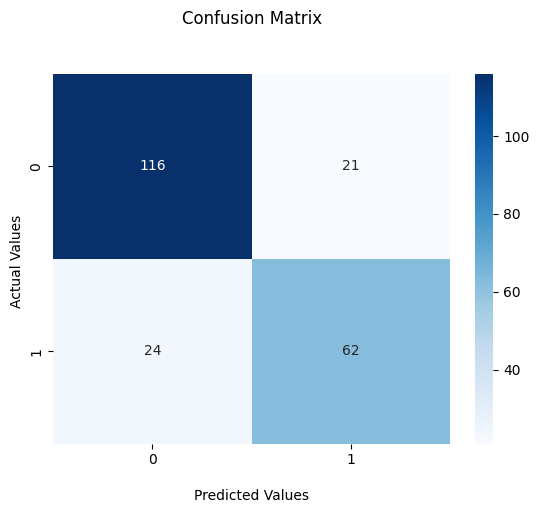

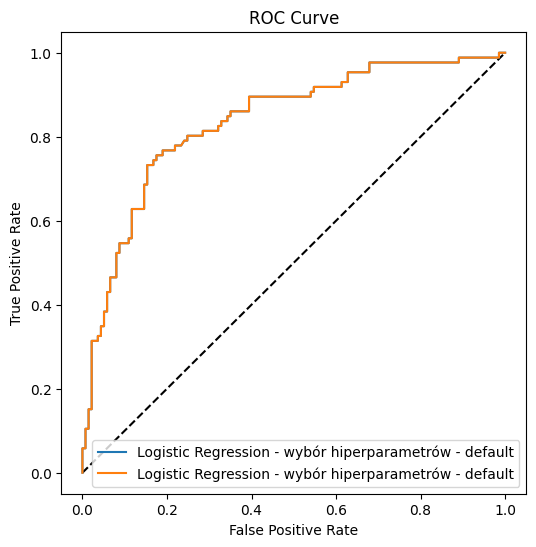

,Model,F1_score,AUC
0,Logistic Regression - wybór hiperparametrów - ...,0.733728,0.836403
1,Logistic Regression - wybór hiperparametrów - ...,0.733728,0.836403


In [12]:
calculate_metrics(model_v1, 'Logistic Regression - wybór hiperparametrów - default', X_test, y_test)

In [14]:
list(model_v1.get_params().keys())

['memory',
 'steps',
 'transform_input',
 'verbose',
 'preprocessor',
 'model',
 'preprocessor__force_int_remainder_cols',
 'preprocessor__n_jobs',
 'preprocessor__remainder',
 'preprocessor__sparse_threshold',
 'preprocessor__transformer_weights',
 'preprocessor__transformers',
 'preprocessor__verbose',
 'preprocessor__verbose_feature_names_out',
 'preprocessor__numeric_preprocessing',
 'preprocessor__categorical_preprocessing',
 'preprocessor__numeric_preprocessing__memory',
 'preprocessor__numeric_preprocessing__steps',
 'preprocessor__numeric_preprocessing__transform_input',
 'preprocessor__numeric_preprocessing__verbose',
 'preprocessor__numeric_preprocessing__fill_missings',
 'preprocessor__numeric_preprocessing__polynomial_features',
 'preprocessor__numeric_preprocessing__scaler_1',
 'preprocessor__numeric_preprocessing__pca',
 'preprocessor__numeric_preprocessing__scaler_2',
 'preprocessor__numeric_preprocessing__fill_missings__add_indicator',
 'preprocessor__numeric_preprocess


[CV 7/10; 1874/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 7/10; 1874/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2;, score=0.870 total time=   0.0s
[CV 8/10; 1874/2000] START model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=2
[CV 8/10; 1874/2000] END model__C=3237.45754281764, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessi


[CV 10/10; 1923/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 10/10; 1923/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.792 total time=   0.0s
[CV 1/10; 1924/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 1/10; 1924/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85, preprocessor__numeric_preprocessing


[CV 5/10; 1947/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 5/10; 1947/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3;, score=0.921 total time=   0.0s
[CV 6/10; 1947/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessing__polynomial_features__degree=3
[CV 6/10; 1947/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9, preprocessor__numeric_preprocessi


[CV 8/10; 1936/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 8/10; 1936/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.768 total time=   0.0s
[CV 9/10; 1936/2000] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 9/10; 1936/2000] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__


[CV 9/10; 1896/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.792 total time=   0.0s
[CV 10/10; 1896/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4
[CV 10/10; 1896/2000] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99, preprocessor__numeric_preprocessing__polynomial_features__degree=4;, score=0.797 total time=   0.0s
[CV 1/10; 1897/2000] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99

In [27]:
# redukcja wymiarowości
from sklearn.decomposition import MiniBatchSparsePCA

from sklearn.preprocessing import RobustScaler

num_features = ['Age', 'SibSp', 'Parch', 'Fare']
cat_features = ['Name', 'Sex', 'Embarked']

# przygotowanie wartości numerycznych
num_preparation = Pipeline(steps=[
    ('fill_missings', SimpleImputer(strategy='mean')),
    ('logical_regretion', LogisticRegression(max_iter=1000)),
    ('scaler_1', RobustScaler()),
    ('pca', MiniBatchSparsePCA(n_components=0.95)),
    ('scaler_2', RobustScaler())
])

# przygotowanie wartości kategorycznych
cat_preparation = Pipeline(steps=[
    ('filter_name', Filter_Name(column='Name')),
    ('fill_missings', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(sparse_output=False ,handle_unknown='ignore'))
])

# transformer = wartości numeryczne oraz kategoryczne
data_preparation = ColumnTransformer(transformers=[
    ('numeric_preprocessing', num_preparation, num_features),
    ('categorical_preprocessing', cat_preparation, cat_features)
])

model_pipeline_v1 = Pipeline(steps=[('preprocessor', data_preparation),
                                    ('model', LogisticRegression(max_iter=10000))])
params = {
    'preprocessor__numeric_preprocessing__fill_missings__strategy': ['mean', 'median'],
    'preprocessor__numeric_preprocessing__pca__n_components': [0.85, 0.90, 0.95, 0.99, 0.99999],
    'model__C': np.logspace(-4, 4, 50)
}

grid_search = GridSearchCV(model_pipeline_v1, params, cv=10, n_jobs=-1, verbose=10, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)
print('Wybrane hiperparametry: ', grid_search.best_params_)
model_v1 = grid_search.best_estimator_

Fitting 10 folds for each of 500 candidates, totalling 5000 fits
[CV 9/10; 1/500] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 9/10; 1/500] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 7/10; 2/500] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 7/10; 2/500] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 2/10; 3/500] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 2/10; 3/500] END model__C=0.0001, prepro

[CV 10/10; 131/500] END model__C=0.013257113655901081, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s[CV 2/10; 1/500] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 2/10; 1/500] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 6/10; 2/500] START model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 6/10; 2/500] END model__C=0.0001, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 1/10; 3/500] START model__C=0.0001, preprocessor__numeric_pr

[CV 8/10; 62/500] START model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 8/10; 62/500] END model__C=0.0009540954763499944, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 5/10; 88/500] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 5/10; 88/500] END model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 6/10; 88/500] START model__C=0.0020235896477251557, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 6/10; 88/500] END m

[CV 1/10; 175/500] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total time=   0.0s
[CV 2/10; 175/500] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999
[CV 2/10; 175/500] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total time=   0.0s
[CV 3/10; 175/500] START model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999
[CV 3/10; 175/500] END model__C=0.05963623316594643, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total t

[CV 2/10; 117/500] END model__C=0.0062505519252739694, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 3/10; 149/500] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 3/10; 149/500] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99;, score=nan total time=   0.0s
[CV 4/10; 149/500] START model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 4/10; 149/500] END model__C=0.019306977288832496, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99;, score=nan total t

[CV 3/10; 208/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 3/10; 208/500] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 4/10; 208/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 4/10; 208/500] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 5/10; 208/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 5/10; 208/500] END

[CV 7/10; 201/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 7/10; 201/500] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 8/10; 201/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 8/10; 201/500] END model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 9/10; 201/500] START model__C=0.18420699693267145, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 9/10; 201/500] END model__C=

[CV 10/10; 257/500] START model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 10/10; 257/500] END model__C=1.2067926406393288, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 3/10; 309/500] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 3/10; 309/500] END model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99;, score=nan total time=   0.0s
[CV 4/10; 309/500] START model__C=7.9060432109076855, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 4/10; 309/500] END mode

[CV 8/10; 192/500] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 8/10; 192/500] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 9/10; 192/500] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 9/10; 192/500] END model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 10/10; 192/500] START model__C=0.12648552168552957, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 10/10; 192/500] END model__C=0.1

[CV 10/10; 341/500] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 1/10; 342/500] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 1/10; 342/500] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 2/10; 342/500] START model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 2/10; 342/500] END model__C=35.564803062231285, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 3/10; 3

[CV 2/10; 367/500] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 2/10; 367/500] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 3/10; 367/500] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 3/10; 367/500] END model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 4/10; 367/500] START model__C=75.43120063354607, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 4/10; 367/500] END model__C=75.43

[CV 8/10; 478/500] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 9/10; 478/500] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 9/10; 478/500] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 10/10; 478/500] START model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 10/10; 478/500] END model__C=4714.8663634573895, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0

ValueError: 
All the 5000 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5000 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/base.py", line 1363, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 653, in fit
    Xt = self._fit(X, y, routed_params, raw_params=params)
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 587, in _fit
    X, fitted_transformer = fit_transform_one_cached(
                            ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/joblib/memory.py", line 326, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 1539, in _fit_transform_one
    res = transformer.fit_transform(X, y, **params.get("fit_transform", {}))
          ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/utils/_set_output.py", line 316, in wrapped
    data_to_wrap = f(self, X, *args, **kwargs)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/base.py", line 1363, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/compose/_column_transformer.py", line 996, in fit_transform
    result = self._call_func_on_transformers(
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/compose/_column_transformer.py", line 897, in _call_func_on_transformers
    return Parallel(n_jobs=self.n_jobs)(jobs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/utils/parallel.py", line 82, in __call__
    return super().__call__(iterable_with_config_and_warning_filters)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/joblib/parallel.py", line 1986, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/joblib/parallel.py", line 1914, in _get_sequential_output
    res = func(*args, **kwargs)
          ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/utils/parallel.py", line 147, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 1539, in _fit_transform_one
    res = transformer.fit_transform(X, y, **params.get("fit_transform", {}))
          ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/base.py", line 1363, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 717, in fit_transform
    Xt = self._fit(X, y, routed_params)
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 561, in _fit
    self._validate_steps()
  File "/Users/jtadych/Code/venv312/lib/python3.12/site-packages/sklearn/pipeline.py", line 338, in _validate_steps
    raise TypeError(
TypeError: All intermediate steps should be transformers and implement fit and transform or be the string 'passthrough' 'LogisticRegression(max_iter=1000)' (type <class 'sklearn.linear_model._logistic.LogisticRegression'>) doesn't


In [28]:
list(model_v1.get_params().keys())

['memory',
 'steps',
 'transform_input',
 'verbose',
 'preprocessor',
 'model',
 'preprocessor__force_int_remainder_cols',
 'preprocessor__n_jobs',
 'preprocessor__remainder',
 'preprocessor__sparse_threshold',
 'preprocessor__transformer_weights',
 'preprocessor__transformers',
 'preprocessor__verbose',
 'preprocessor__verbose_feature_names_out',
 'preprocessor__numeric_preprocessing',
 'preprocessor__categorical_preprocessing',
 'preprocessor__numeric_preprocessing__memory',
 'preprocessor__numeric_preprocessing__steps',
 'preprocessor__numeric_preprocessing__transform_input',
 'preprocessor__numeric_preprocessing__verbose',
 'preprocessor__numeric_preprocessing__fill_missings',
 'preprocessor__numeric_preprocessing__polynomial_features',
 'preprocessor__numeric_preprocessing__scaler_1',
 'preprocessor__numeric_preprocessing__pca',
 'preprocessor__numeric_preprocessing__scaler_2',
 'preprocessor__numeric_preprocessing__fill_missings__add_indicator',
 'preprocessor__numeric_preprocess

              precision    recall  f1-score   support

           0       0.83      0.85      0.84       137
           1       0.75      0.72      0.73        86

    accuracy                           0.80       223
   macro avg       0.79      0.78      0.79       223
weighted avg       0.80      0.80      0.80       223



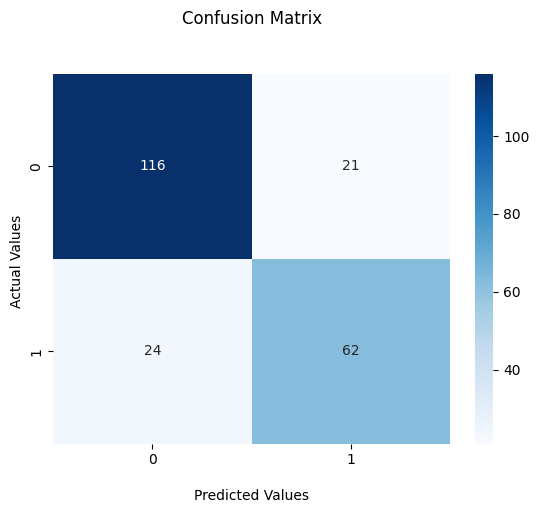

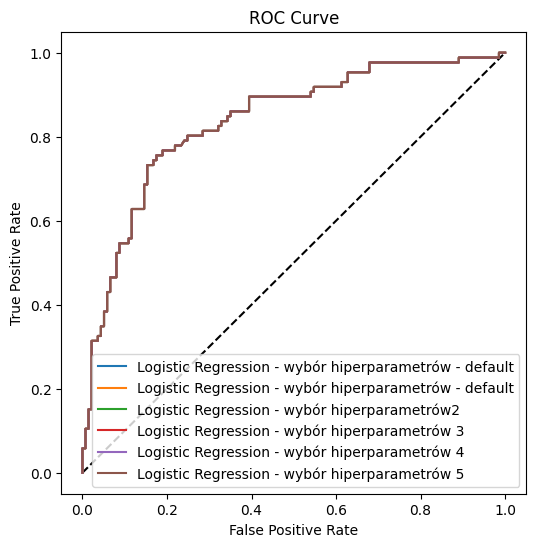

,Model,F1_score,AUC
0,Logistic Regression - wybór hiperparametrów - ...,0.733728,0.836403
1,Logistic Regression - wybór hiperparametrów - ...,0.733728,0.836403
2,Logistic Regression - wybór hiperparametrów2,0.733728,0.836403
3,Logistic Regression - wybór hiperparametrów 3,0.733728,0.836403
4,Logistic Regression - wybór hiperparametrów 4,0.733728,0.836403
5,Logistic Regression - wybór hiperparametrów 5,0.733728,0.836403



[CV 4/10; 435/500] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total time=   0.0s
[CV 5/10; 435/500] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999
[CV 5/10; 435/500] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total time=   0.0s
[CV 6/10; 435/500] START model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999
[CV 6/10; 435/500] END model__C=1048.1131341546852, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.99999;, score=nan total time=


[CV 3/10; 411/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 3/10; 411/500] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 4/10; 411/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 4/10; 411/500] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85;, score=nan total time=   0.0s
[CV 5/10; 411/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.85
[CV 5/10; 411/500] END model__C=494.17133


[CV 7/10; 417/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 7/10; 417/500] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 8/10; 417/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 8/10; 417/500] END model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 9/10; 417/500] START model__C=494.1713361323828, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 9/10; 417/500] END model__C=494.


[CV 4/10; 487/500] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 4/10; 487/500] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 5/10; 487/500] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9
[CV 5/10; 487/500] END model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.9;, score=nan total time=   0.0s
[CV 1/10; 489/500] START model__C=6866.488450042998, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 1/10; 489/500] END model__C=686


[CV 9/10; 448/500] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 9/10; 448/500] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 10/10; 448/500] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 10/10; 448/500] END model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 1/10; 449/500] START model__C=1526.4179671752302, preprocessor__numeric_preprocessing__fill_missings__strategy=median, preprocessor__numeric_preprocessing__pca__n_components=0.99
[CV 1/10; 449/500] END m


[CV 7/10; 493/500] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 7/10; 493/500] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 8/10; 493/500] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 8/10; 493/500] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95;, score=nan total time=   0.0s
[CV 9/10; 493/500] START model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings__strategy=mean, preprocessor__numeric_preprocessing__pca__n_components=0.95
[CV 9/10; 493/500] END model__C=10000.0, preprocessor__numeric_preprocessing__fill_missings

In [29]:
calculate_metrics(model_v1, 'Logistic Regression - wybór hiperparametrów 5', X_test, y_test)